In [1]:
import tensorflow as tf
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.compat.v1.Session(config=config)

In [2]:
import keras
import pandas as pd
import tensorflow as tf

import numpy as np
from numpy import expand_dims
from numpy import zeros
from numpy import ones
from numpy import asarray
from numpy.random import randn
from numpy.random import randint

# from keras.models import Sequential, Model
# from keras.layers import Dense, Dropout, Activation, Flatten, Convolution2D, MaxPooling2D, GlobalAveragePooling2D
from keras.utils import np_utils
from keras.utils.vis_utils import plot_model

from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Convolution2D, MaxPooling2D, GlobalAveragePooling2D, Input,AveragePooling2D, BatchNormalization, LeakyReLU, SpatialDropout2D, Lambda, Reshape, Conv2DTranspose, Conv2D

# from keras.applications import MobileNet
# from keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2, InceptionV3
from tensorflow.keras.optimizers import Adam
from keras import backend


from matplotlib import pyplot as plt
import os
from sklearn.model_selection import train_test_split

import seaborn as sns
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.model_selection import KFold

from collections import defaultdict,Counter
from imblearn.over_sampling import SMOTE
from PIL import Image

from kerastuner import HyperModel

<h2>Data Loading and Preparation</h2>

In [3]:
def getSpeciesCode(x):
    part = x.split('_')
    if part[0] == 'ASETRI':
        return 0
    elif part[0] == 'EPTBOT':
        return 1
    elif part[0] == 'MYOEMA':
        return 2
    elif part[0] == 'PIPKUH':
        return 3
    elif part[0] == 'RHIMUS':
        return 4
    elif part[0] == 'RHYNAS':
        return 5
    elif part[0] == 'ROUAEG':
        return 6
    elif part[0] == 'TAPPER':
        return 7
    else:
        return 'Unknown'
    
def getSpecies(x):
    if x == 0:
        return 'A.tridens'
    elif x == 1:
        return 'E.bottae'
    elif x == 2:
        return 'M.emarginatus'
    elif x == 3:
        return 'P.kuhli'
    elif x == 4:
        return 'R.muscatellum'
    elif x == 5:
        return 'R.nasutus'
    elif x == 6:
        return 'R.aegyptius'
    elif x == 7:
        return 'T.perforatus'
    elif x == 8:
        return 'No_Bat'
    else:
        return 'Unknown'
    
    
def generate_actual_predicted(Y_pred, X_test, Y_test): 
    predicted = list()
    for i in range(len(Y_pred)):
        predicted.append(np.argmax(Y_pred[i]))
        
    actual = list()
    for i in range(len(Y_test)):
        actual.append(np.argmax(Y_test[i]))
        
    return actual, predicted



# # Ytrain in Onehot encoded form 
# def makeOverSamplesSMOTE(X_train,Y_train):
    
#     Y_train_labelled=[]
#     X_dims=X_train.shape

#     for i in range(len(Y_train)):
#         Y_train_labelled.append(np.argmax(Y_train[i]))

#     print('Original trainingset shape %s' %  [(getSpecies(k),v) for k,v in Counter(Y_train_labelled).items()])       
#     X_train= X_train.reshape(-1,X_dims[1]*X_dims[2]*X_dims[3])

#     sm = SMOTE(sampling_strategy='all',k_neighbors=5)
#     X_train, Y_train_labelled = sm.fit_resample(X_train, Y_train_labelled)


#     print('Resampled training set shape %s' % [(getSpecies(k),v) for k,v in Counter(Y_train_labelled).items()])


#     #reshape X_all
#     X_train= X_train.reshape(-1,X_dims[1],X_dims[2],X_dims[3])

#     # update Y_train
#     Y_train= np_utils.to_categorical(Y_train_labelled, num_classes=9)

#     print("After OverSampling\nX_train: shape= ",X_train.shape)
#     print("Y_train: shape= ",Y_train.shape)

    
    
#     return(X_train,Y_train)

In [4]:
image_folder_path = '../../data/SpectogramInitial'
file_paths = [f for f in os.listdir(image_folder_path)]
species = []
for file_name in file_paths:
    sp = file_name.split('_')
    species.append(sp[0])

df = pd.DataFrame(species, columns=['Species'])
df['Species'].value_counts()

RHIMUS    1665
TAPPER     403
PIPKUH     299
RHYNAS     269
EPTBOT     124
ROUAEG     121
MYOEMA     112
ASETRI      25
Name: Species, dtype: int64

In [5]:
X_all = []
Y_all = []

image_folder_path = '../../data/SpectogramInitial'
file_paths = [f for f in os.listdir(image_folder_path)]

for file_name in file_paths:
    spectrogram = Image.open(image_folder_path + '/' + file_name)
    spectrogram = spectrogram.convert('RGB')
    spectrogram = spectrogram.resize((168, 112))  
    spectrogram = np.array(spectrogram)
    #spectrogram = np.expand_dims(spectrogram, axis=2) 
    X_all.append(spectrogram)
    Y_all.append(getSpeciesCode(file_name))


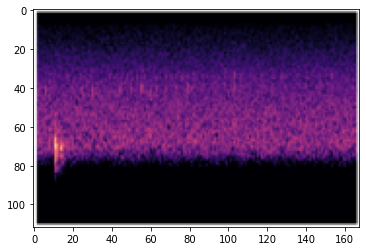

In [6]:
plt.imshow(X_all[1])

In [7]:
#Load Noise
image_folder_path = '../../data/noise'
file_paths = [f for f in os.listdir(image_folder_path)]

for file_name in file_paths:
    spectrogram = Image.open(image_folder_path + '/' + file_name)
    spectrogram = spectrogram.convert('RGB')
    spectrogram = spectrogram.resize((168, 112))  
    spectrogram = np.array(spectrogram)
    #spectrogram = np.expand_dims(spectrogram, axis=2) 
    X_all.append(spectrogram)
    Y_all.append(8)


In [8]:
X_all = np.array(X_all)
Y_all = np.array(Y_all)

print(X_all.shape)
print(Y_all.shape)

X_all = X_all.astype('float32')
X_all = (X_all - 127.5) / 127.5

Y_all = np_utils.to_categorical(Y_all, num_classes=9) 


(3426, 112, 168, 3)
(3426,)


In [9]:
#X_all

In [10]:
# train /test= 80/20% split
# Data is stratified
X_train, X_test, Y_train, Y_test = train_test_split(X_all, Y_all, test_size=0.2, random_state = 245, stratify=Y_all)
print(Y_train.shape)

(2740, 9)


In [11]:
y_arr =np.argmax(Y_train, axis=1)
print(y_arr.shape)
unique_elements, counts_elements = np.unique(y_arr, return_counts=True)
print("Frequency of unique values of the said array:")
print(np.asarray((unique_elements, counts_elements)))

(2740,)
Frequency of unique values of the said array:
[[   0    1    2    3    4    5    6    7    8]
 [  20   99   90  239 1332  215   97  322  326]]


<h2> Model Definition and Training </h2>

In [12]:
# custom activation function
def custom_activation(output):
    logexpsum = backend.sum(backend.exp(output), axis=-1, keepdims=True)
    result = logexpsum / (logexpsum + 1.0)
    return result

In [13]:
# define the standalone supervised and unsupervised discriminator models
def define_discriminator(n_classes=9):
    in_image = Input(shape=(112,168,3))
    lay = Convolution2D(filters=56,kernel_size=(7,7),strides=(2,2),padding='same')(in_image)
    lay = BatchNormalization()(lay)
    lay = Activation('relu')(lay)
    lay = MaxPooling2D(pool_size=(2,2),strides=2,padding='same')(lay)
    lay = Dropout(0.3)(lay)

    lay = Convolution2D(filters=72,kernel_size=(5,5),strides=(2,2),padding='same')(lay)
    lay = BatchNormalization()(lay)
    lay = Activation('relu')(lay)
    lay = AveragePooling2D(pool_size=(2,2),strides=2,padding='same')(lay)
    lay = Dropout(0.3)(lay)

    lay = Convolution2D(filters=56,kernel_size=(3,3),strides=(1,1),padding='same')(lay)
    lay = BatchNormalization()(lay)
    lay = Activation('relu')(lay)
    lay = AveragePooling2D(pool_size=(2,2),strides=2,padding='same')(lay)
    lay = Dropout(0.3)(lay)

    lay = Convolution2D(filters=72,kernel_size=(3,3),strides=(1,1),padding='same')(lay)
    lay = BatchNormalization()(lay)
    lay = Activation('relu')(lay)
    lay = AveragePooling2D(pool_size=(2,2),strides=2,padding='same')(lay)
    lay = Dropout(0.3)(lay)

    lay = Flatten()(lay)

    lay = Dense(48)(lay)
    lay = BatchNormalization()(lay)
    lay = Activation('relu')(lay)
    lay = Dropout(0.15)(lay)
    lay = Dense(n_classes)(lay)
    # supervised output
    c_out_layer = Activation('softmax')(lay)
    # define and compile supervised discriminator model
    c_model = Model(in_image, c_out_layer)
    c_model.compile(
        loss='sparse_categorical_crossentropy', 
        optimizer=Adam(lr=0.003, beta_1=0.5), 
        metrics=['accuracy'])
 
    
    # unsupervised output
    d_out_layer = Lambda(custom_activation)(lay)
    # define and compile unsupervised discriminator model
    d_model = Model(in_image, d_out_layer)
    d_model.compile(
        loss='binary_crossentropy', 
        optimizer=Adam(lr=0.0002, beta_1=0.5))
    return d_model, c_model

In [14]:
# # create model
# d_model, c_model = define_discriminator()
# # plot the model
# c_model.summary()
# d_model.summary()

In [15]:
# define the standalone generator model
def define_generator(latent_dim):
    # image generator input
    in_lat = Input(shape=(latent_dim,))
    # foundation for 7x7 image
    n_nodes = 128 * 28 * 42
    gen = Dense(n_nodes)(in_lat)
    gen = LeakyReLU(alpha=0.2)(gen)
    gen = Reshape((28, 42, 128))(gen)
    # upsample to double -56*84
    gen = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(gen)
    gen = LeakyReLU(alpha=0.2)(gen)
    # upsample to double- 112*168
    gen = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(gen)
    gen = LeakyReLU(alpha=0.2)(gen)
    # output
    out_layer = Conv2D(3, (7,7), activation='tanh', padding='same')(gen)
    # define model
    model = Model(in_lat, out_layer)
    return model

In [16]:
# # size of the latent space
# latent_dim = 100

# g_model = define_generator(latent_dim)
# g_model.summary()

In [17]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
    # make weights in the discriminator not trainable
    d_model.trainable = False
    # connect image output from generator as input to discriminator
    gan_output = d_model(g_model.output)
    # define gan model as taking noise and outputting a classification
    model = Model(g_model.input, gan_output)
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model
 

In [18]:
# select a supervised subset of the dataset, ensures classes are balanced
def select_supervised_samples(dataset, n_samples=20, n_classes=9):
    X, y = dataset
    y = np.argmax(y, axis=1)
    X_list, y_list = list(), list()
    n_per_class = int(n_samples / n_classes)
    for i in range(n_classes):
        # get all images for this class
        X_with_class = X[y == i]
        # choose random instances
        ix = randint(0, len(X_with_class), n_per_class)
        # add to list
        [X_list.append(X_with_class[j]) for j in ix]
        [y_list.append(i) for j in ix]
    return asarray(X_list), asarray(y_list)

In [19]:
# select real samples
def generate_real_samples(dataset, n_samples):
	# split into images and labels
	images, labels = dataset
	# choose random instances
	ix = randint(0, images.shape[0], n_samples)
	# select images and labels
	X, labels = images[ix], labels[ix]
	# generate class labels
	y = ones((n_samples, 1))
	return [X, labels], y

In [20]:
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	z_input = randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	z_input = z_input.reshape(n_samples, latent_dim)
	return z_input

In [21]:
# use the generator to generate n fake examples, with class labels
def generate_fake_samples(generator, latent_dim, n_samples):
	# generate points in latent space
	z_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	images = generator.predict(z_input)
	# create class labels
	y = zeros((n_samples, 1))
	return images, y

In [22]:
# generate samples and save as a plot and save the model
def summarize_performance(step, g_model, c_model, latent_dim, dataset,d1_hist, d2_hist, g_hist, n_samples=20):
    # prepare fake examples
    X, _ = generate_fake_samples(g_model, latent_dim, 1)
    # scale from [-1,1] to [0,1]
    X = (X + 1) / 2.0
    # plot images
    plt.imshow(X[0, :, :, :])
    plt.show()
    if step%5==0:
        plot_history(d1_hist, d2_hist, g_hist)
    # evaluate the classifier model
    X, y = dataset
    y = np.argmax(y, axis=1)
    _, acc = c_model.evaluate(X, y, verbose=0)
    print('Classifier Accuracy: %.3f%%' % (acc * 100))
    # save the generator model
    filename2 = './models/g_model_%04d.h5' % (step+1)
    #g_model.save(filename2)
    # save the classifier model
    filename3 = './models/c_model_%04d.h5' % (step+1)
    #c_model.save(filename3)
#     print('>Saved: %s, %s, and %s' % (filename1, filename2, filename3))

In [23]:
# create a line plot of loss for the gan and save to file
def plot_history(d1_hist, d2_hist, g_hist):
    # plot loss
    plt.figure(figsize=(8,6))
    plt.plot(d1_hist, label='d-real')
    plt.plot(d2_hist, label='d-fake')
    plt.plot(g_hist, label='gen')
    plt.legend()
    plt.show()
    # save plot to file
    #pyplot.savefig('results_baseline/plot_line_plot_loss.png')
    plt.close()

In [24]:
# train the generator and discriminator
def train(g_model, d_model, c_model, gan_model, dataset, latent_dim, d1elist, d2elist, gelist,n_epochs=20, n_batch=16, verbose = False):
#     # select supervised dataset
#     X_sup, y_sup = select_supervised_samples(dataset)
#     print(X_sup.shape, y_sup.shape)

    # calculate the number of batches per training epoch
    bat_per_epo = int(dataset[0].shape[0] / n_batch)
    # calculate the number of training iterations
    n_steps = bat_per_epo * n_epochs
    # calculate the size of half a batch of samples
    half_batch = int(n_batch / 2)
    print('n_epochs=%d, n_batch=%d, 1/2=%d, b/e=%d, steps=%d' % (n_epochs, n_batch, half_batch, bat_per_epo, n_steps))
    # manually enumerate epochs
    X, y = dataset
    print(X.shape,"Y",y.shape)
    
    d1_hist, d2_hist, g_hist = list(), list(), list()
    
    for epoch in range(n_epochs):
        tempd1list, tempd2list, tempglist = list(), list(), list()
        for bat in range(bat_per_epo):
            #Get index range for the data for this batch
            start = bat * (n_batch)
            middle = start + (half_batch)
            end = (bat+1)* n_batch 

            # update supervised discriminator (c) - half batch
            c_loss, c_acc = c_model.train_on_batch(X[start:middle], np.argmax(y[start:middle], axis=1))
            # update unsupervised discriminator (d) - half batch
            #I will just use the y_real from the original code, which is just ones
            [_, _], y_real = generate_real_samples(dataset, half_batch)
            d_loss1 = d_model.train_on_batch(X[middle:end], y_real)
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            d_loss2 = d_model.train_on_batch(X_fake, y_fake)
            # update generator (g)
            X_gan, y_gan = generate_latent_points(latent_dim, n_batch), ones((n_batch, 1))
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
            
            # record history
            d1_hist.append(d_loss1)
            d2_hist.append(d_loss2)
            g_hist.append(g_loss)
            
            tempd1list.append(d_loss1)
            tempd2list.append(d_loss2)
            tempglist.append(g_loss)
            
            if(verbose):
                print('>%d, c[%.3f,%.0f], d[%.3f,%.3f], g[%.3f]' % (bat+1, c_loss, c_acc*100, d_loss1, d_loss2, g_loss))
       
        # evaluate the model performance every epoch
        print("Epoch ", epoch)
        summarize_performance(epoch, g_model, c_model, latent_dim, dataset,d1_hist, d2_hist, g_hist)
        
        d1elist.append(sum(tempd1list)/len(tempd1list))
        d2elist.append(sum(tempd2list)/len(tempd2list))
        gelist.append(sum(tempglist)/len(tempglist))
    
    #plot_history(d1_hist, d2_hist, g_hist)

n_epochs=100, n_batch=16, 1/2=8, b/e=171, steps=17100
(2740, 112, 168, 3) Y (2740, 9)
Epoch  0


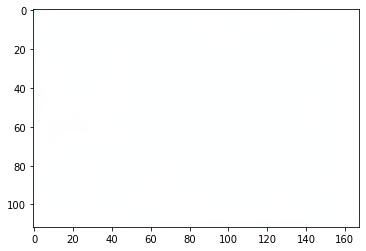

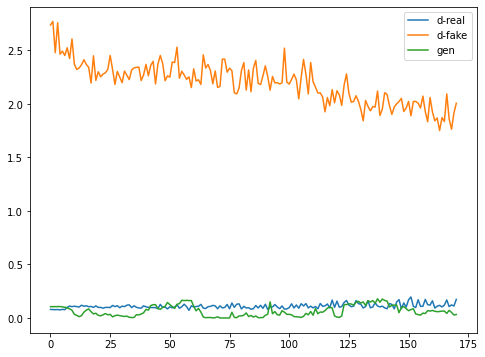

Classifier Accuracy: 50.985%
Epoch  1


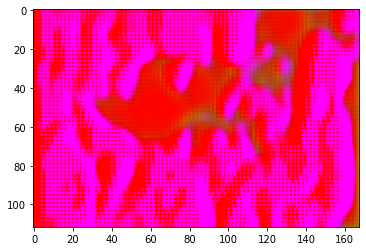

Classifier Accuracy: 63.796%
Epoch  2


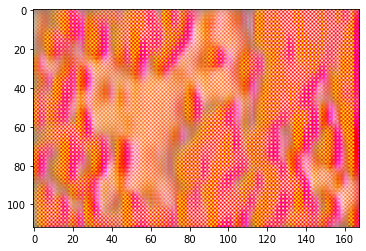

Classifier Accuracy: 62.518%
Epoch  3


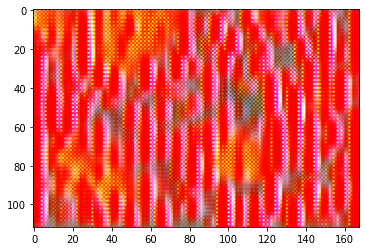

Classifier Accuracy: 59.015%
Epoch  4


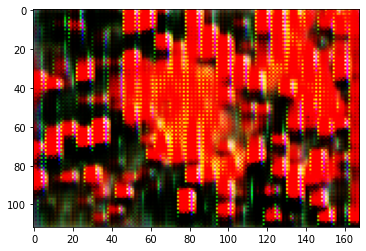

Classifier Accuracy: 65.000%
Epoch  5


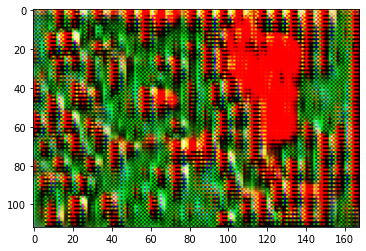

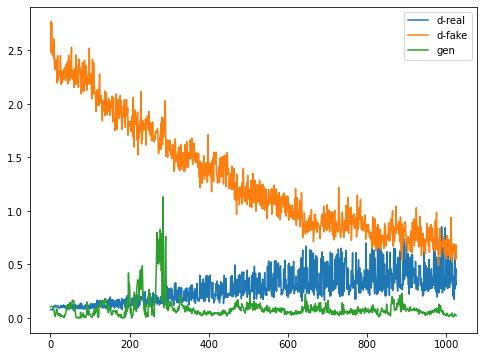

Classifier Accuracy: 67.190%
Epoch  6


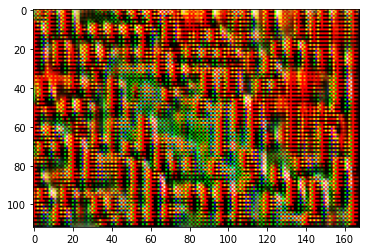

Classifier Accuracy: 68.832%
Epoch  7


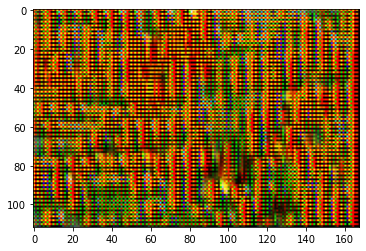

Classifier Accuracy: 74.818%
Epoch  8


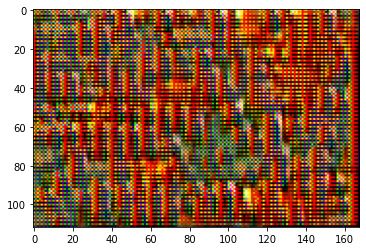

Classifier Accuracy: 76.168%
Epoch  9


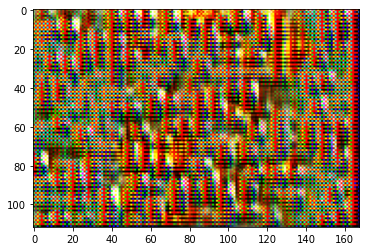

Classifier Accuracy: 74.124%
Epoch  10


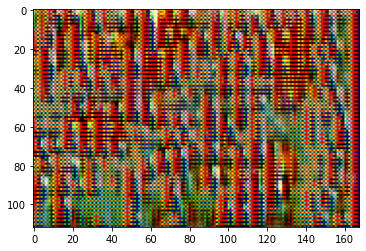

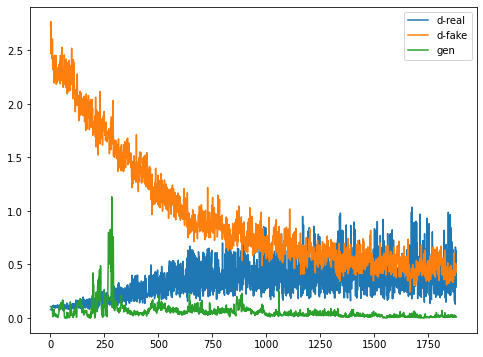

Classifier Accuracy: 79.635%
Epoch  11


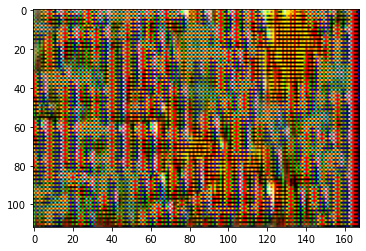

Classifier Accuracy: 79.854%
Epoch  12


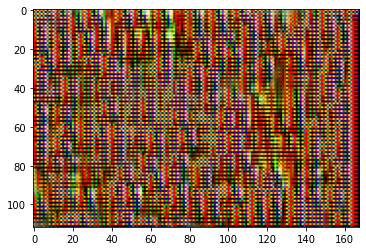

Classifier Accuracy: 79.161%
Epoch  13


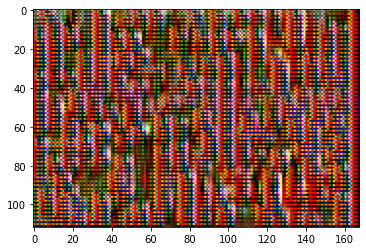

Classifier Accuracy: 82.920%
Epoch  14


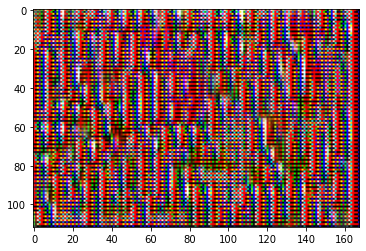

Classifier Accuracy: 80.584%
Epoch  15


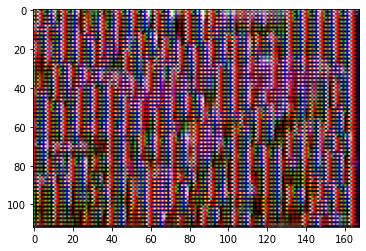

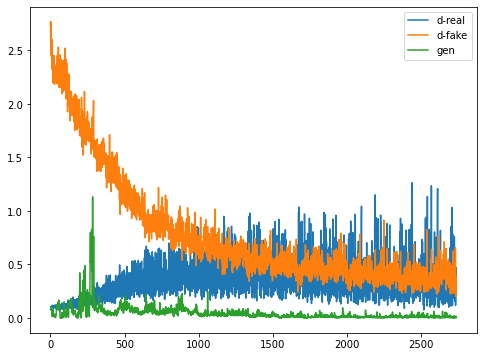

Classifier Accuracy: 81.715%
Epoch  16


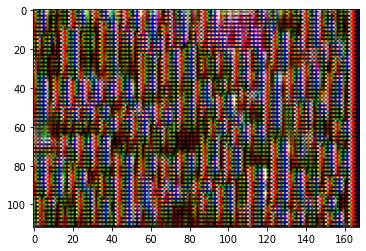

Classifier Accuracy: 83.978%
Epoch  17


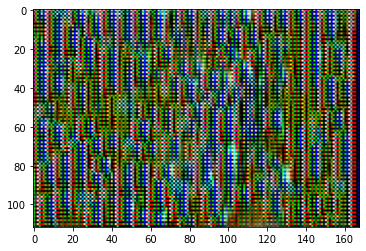

Classifier Accuracy: 76.861%
Epoch  18


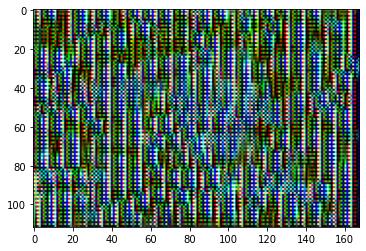

Classifier Accuracy: 80.109%
Epoch  19


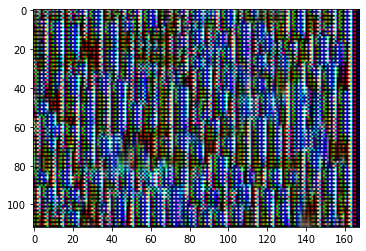

Classifier Accuracy: 84.526%
Epoch  20


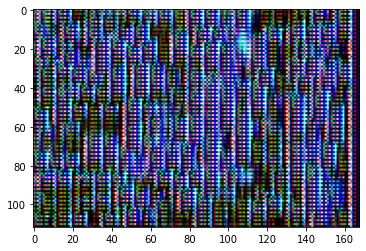

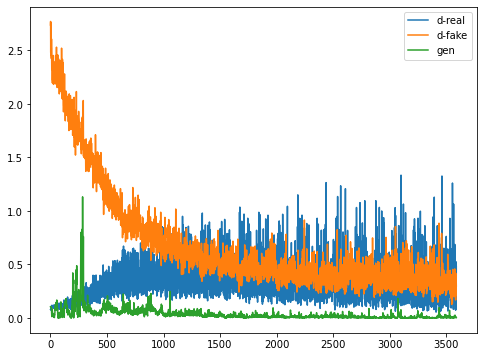

Classifier Accuracy: 78.504%
Epoch  21


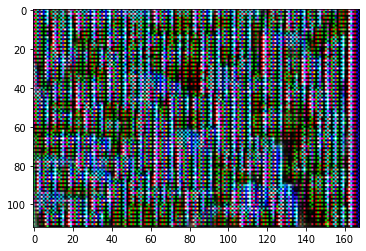

Classifier Accuracy: 81.752%
Epoch  22


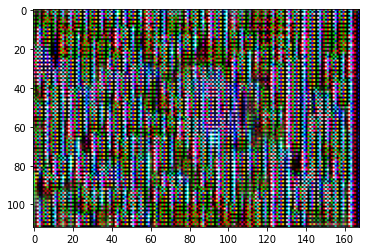

Classifier Accuracy: 87.591%
Epoch  23


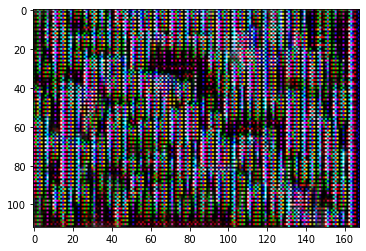

Classifier Accuracy: 88.248%
Epoch  24


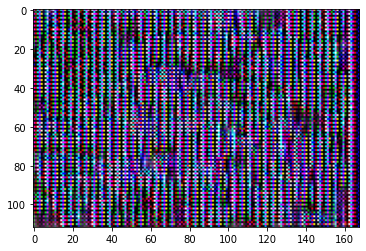

Classifier Accuracy: 87.883%
Epoch  25


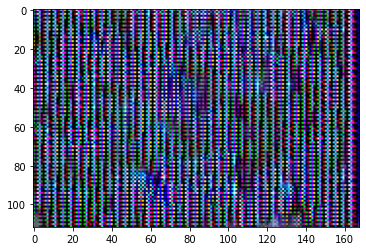

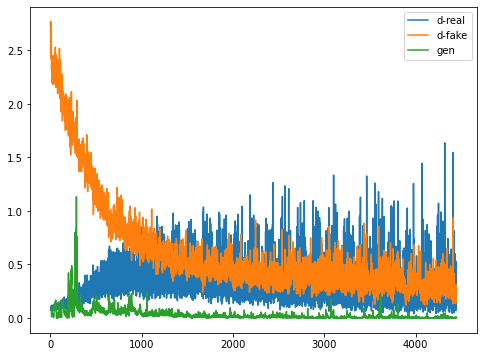

Classifier Accuracy: 83.650%
Epoch  26


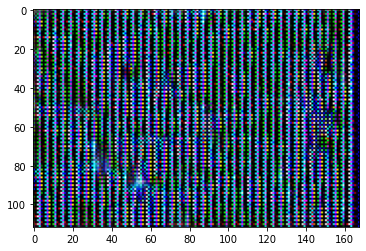

Classifier Accuracy: 90.620%
Epoch  27


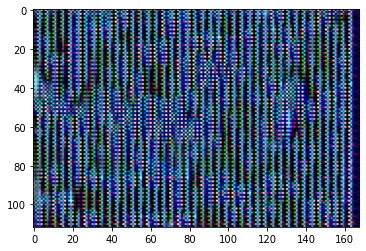

Classifier Accuracy: 85.328%
Epoch  28


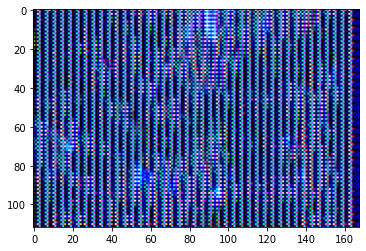

Classifier Accuracy: 88.029%
Epoch  29


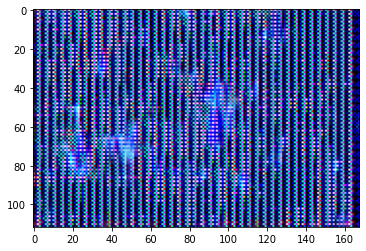

Classifier Accuracy: 79.197%
Epoch  30


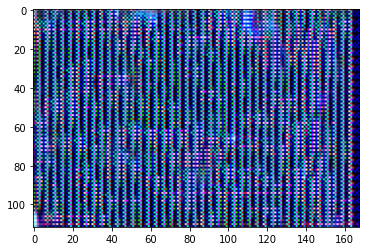

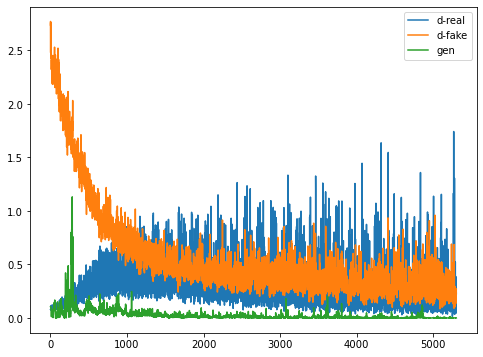

Classifier Accuracy: 90.365%
Epoch  31


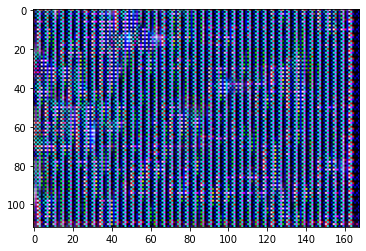

Classifier Accuracy: 88.321%
Epoch  32


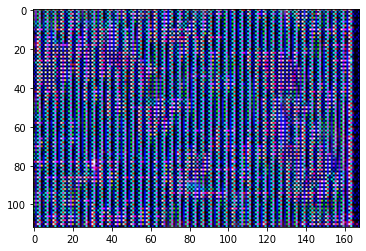

Classifier Accuracy: 86.460%
Epoch  33


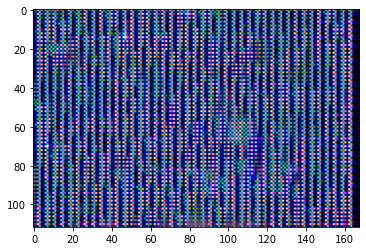

Classifier Accuracy: 78.431%
Epoch  34


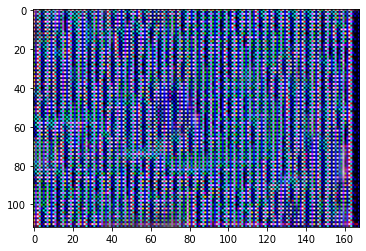

Classifier Accuracy: 83.394%
Epoch  35


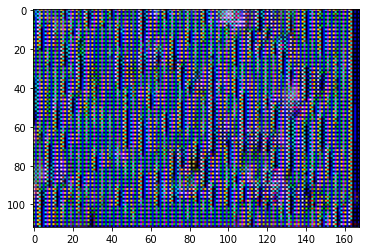

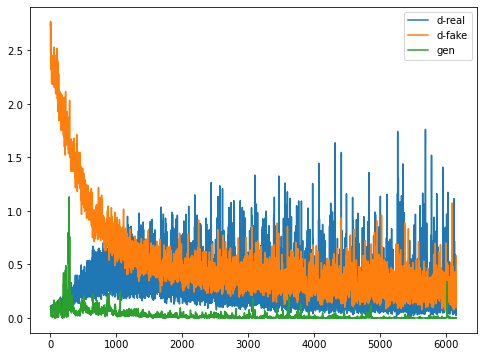

Classifier Accuracy: 83.796%
Epoch  36


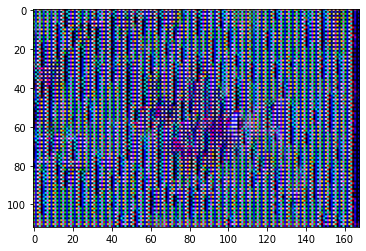

Classifier Accuracy: 86.350%
Epoch  37


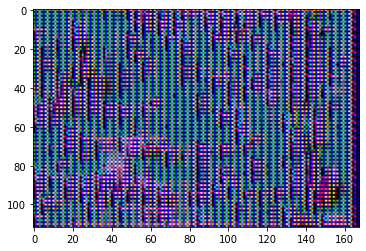

Classifier Accuracy: 80.766%
Epoch  38


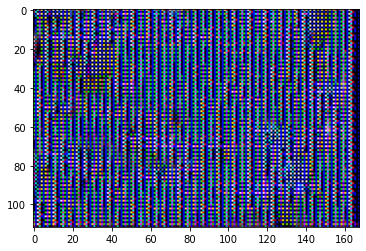

Classifier Accuracy: 80.985%
Epoch  39


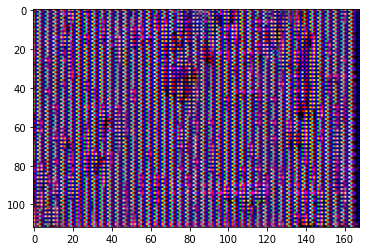

Classifier Accuracy: 93.321%
Epoch  40


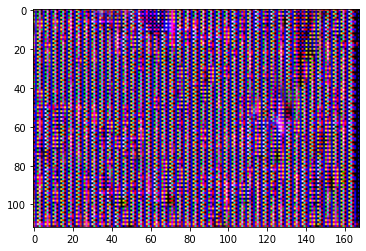

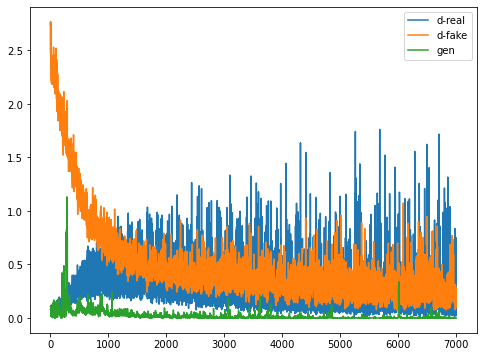

Classifier Accuracy: 89.672%
Epoch  41


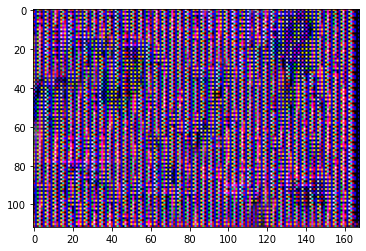

Classifier Accuracy: 89.672%
Epoch  42


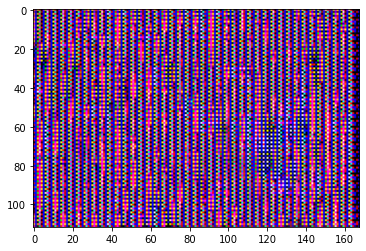

Classifier Accuracy: 83.577%
Epoch  43


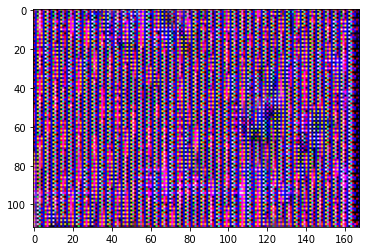

Classifier Accuracy: 77.993%
Epoch  44


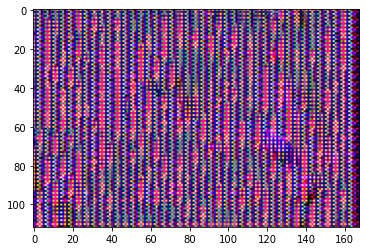

Classifier Accuracy: 79.051%
Epoch  45


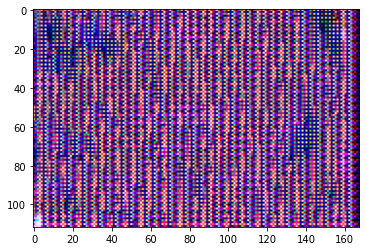

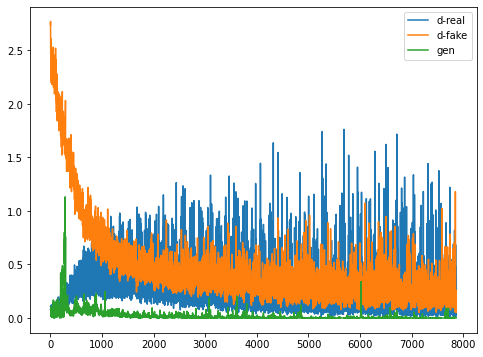

Classifier Accuracy: 83.248%
Epoch  46


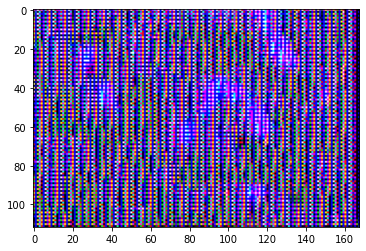

Classifier Accuracy: 80.365%
Epoch  47


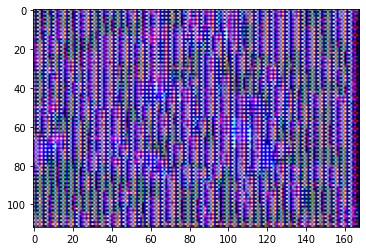

Classifier Accuracy: 72.482%
Epoch  48


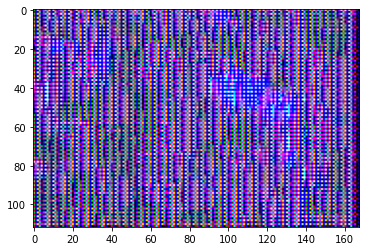

Classifier Accuracy: 85.073%
Epoch  49


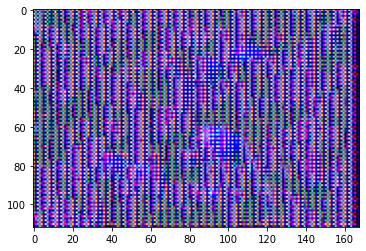

Classifier Accuracy: 82.372%
Epoch  50


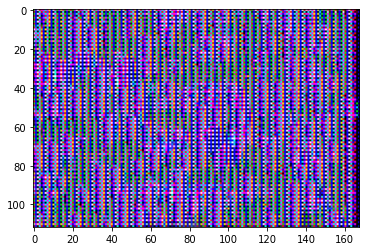

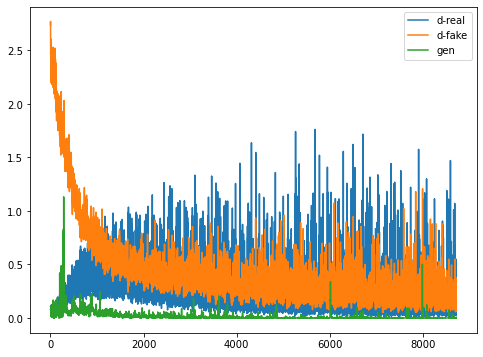

Classifier Accuracy: 81.825%
Epoch  51


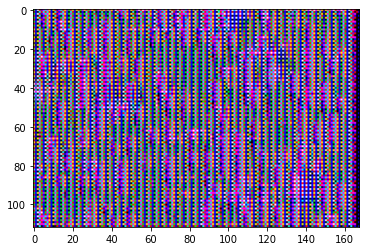

Classifier Accuracy: 84.380%
Epoch  52


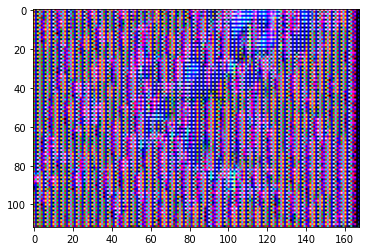

Classifier Accuracy: 82.007%
Epoch  53


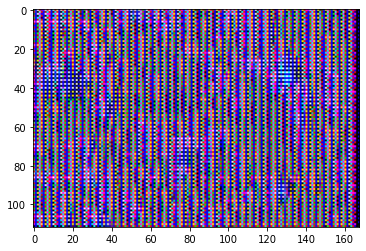

Classifier Accuracy: 84.051%
Epoch  54


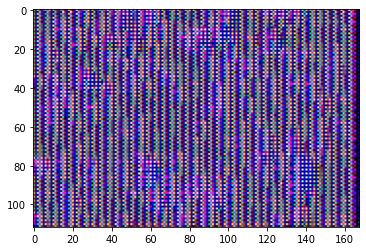

Classifier Accuracy: 72.701%
Epoch  55


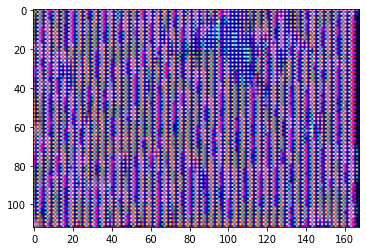

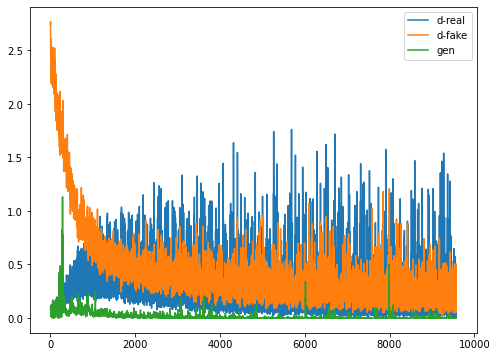

Classifier Accuracy: 86.204%
Epoch  56


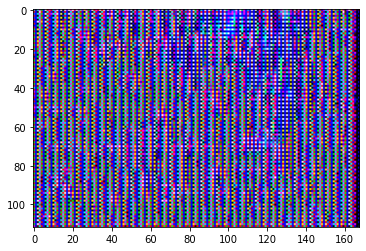

Classifier Accuracy: 80.438%
Epoch  57


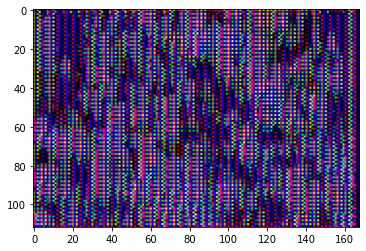

Classifier Accuracy: 89.307%
Epoch  58


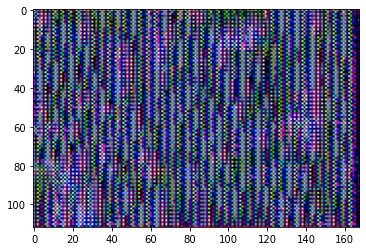

Classifier Accuracy: 86.423%
Epoch  59


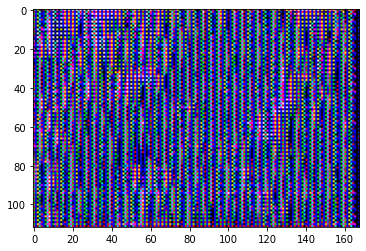

Classifier Accuracy: 86.861%
Epoch  60


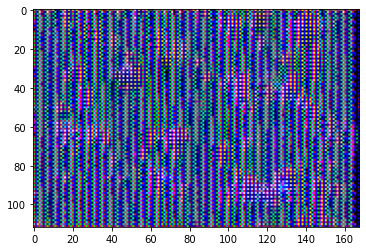

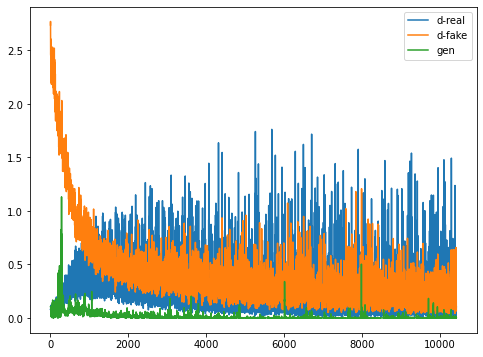

Classifier Accuracy: 85.474%
Epoch  61


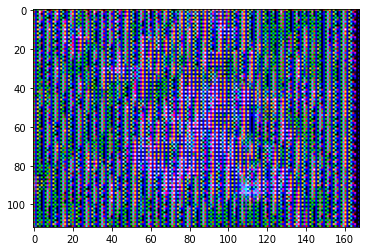

Classifier Accuracy: 86.971%
Epoch  62


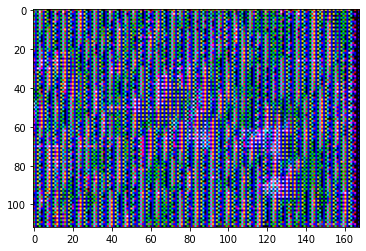

Classifier Accuracy: 84.343%
Epoch  63


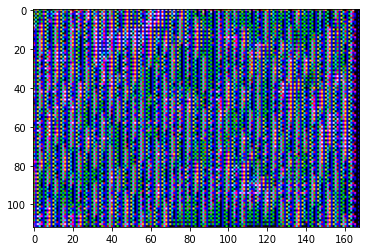

Classifier Accuracy: 90.036%
Epoch  64


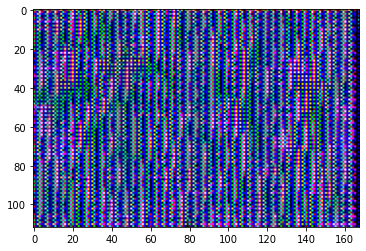

Classifier Accuracy: 85.182%
Epoch  65


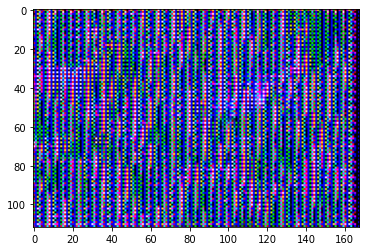

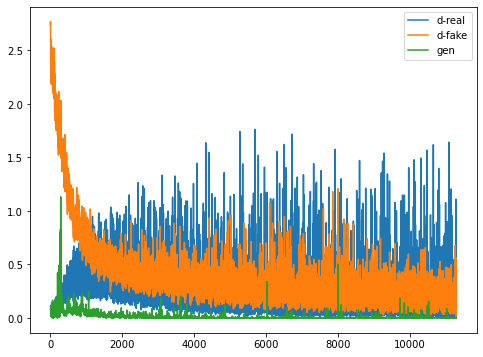

Classifier Accuracy: 85.073%
Epoch  66


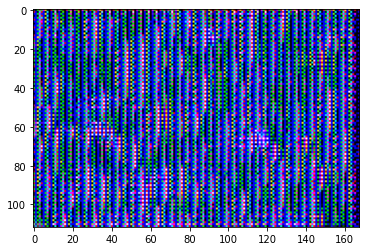

Classifier Accuracy: 75.401%
Epoch  67


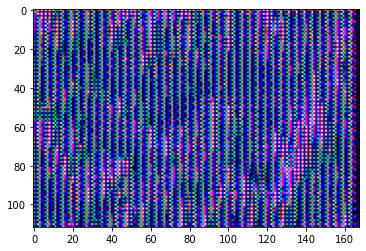

Classifier Accuracy: 82.445%
Epoch  68


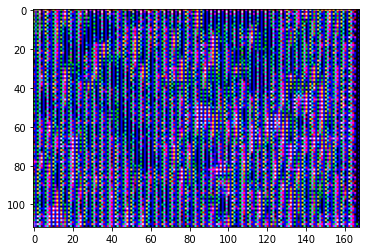

Classifier Accuracy: 82.737%
Epoch  69


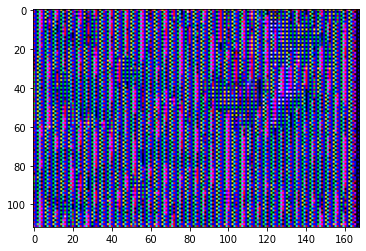

Classifier Accuracy: 93.358%
Epoch  70


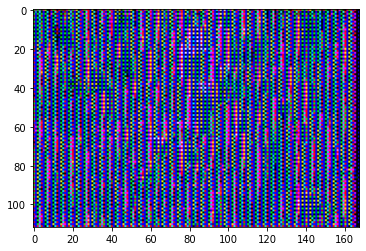

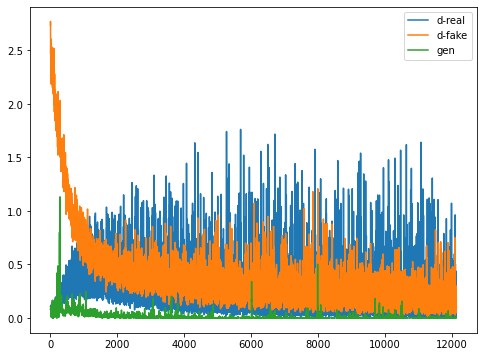

Classifier Accuracy: 81.934%
Epoch  71


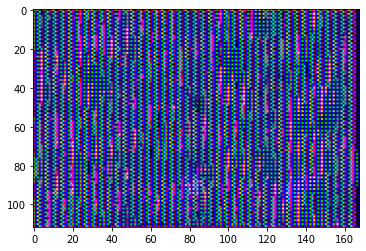

Classifier Accuracy: 76.788%
Epoch  72


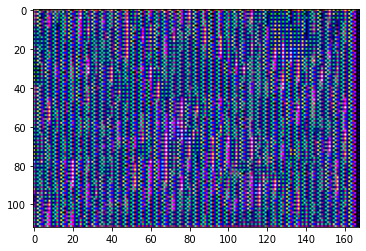

Classifier Accuracy: 90.292%
Epoch  73


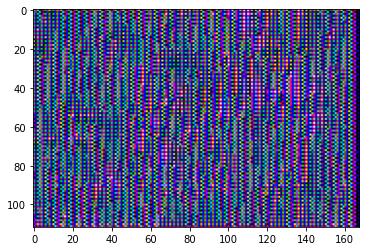

Classifier Accuracy: 90.876%
Epoch  74


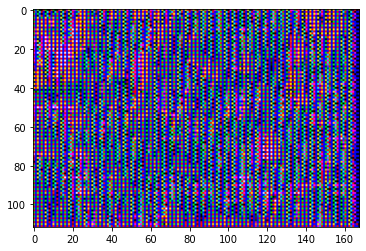

Classifier Accuracy: 87.007%
Epoch  75


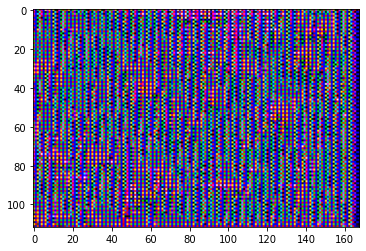

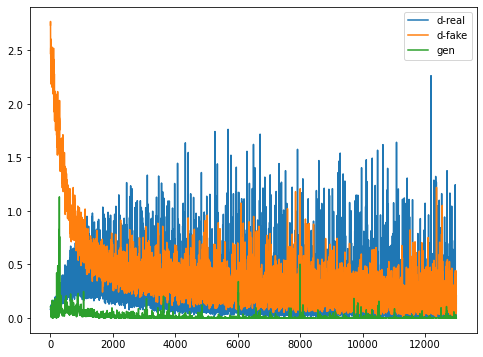

Classifier Accuracy: 87.153%
Epoch  76


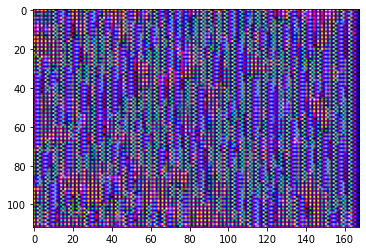

Classifier Accuracy: 81.423%
Epoch  77


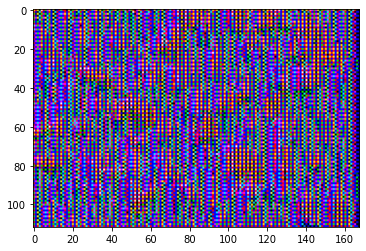

Classifier Accuracy: 89.635%
Epoch  78


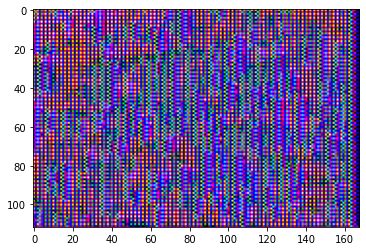

Classifier Accuracy: 85.292%
Epoch  79


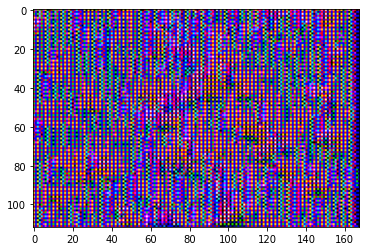

Classifier Accuracy: 85.985%
Epoch  80


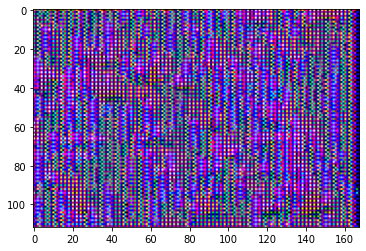

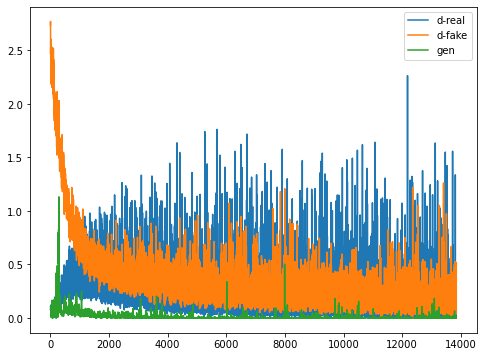

Classifier Accuracy: 77.482%
Epoch  81


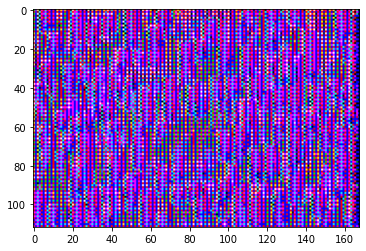

Classifier Accuracy: 80.000%
Epoch  82


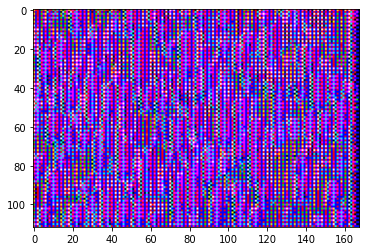

Classifier Accuracy: 88.467%
Epoch  83


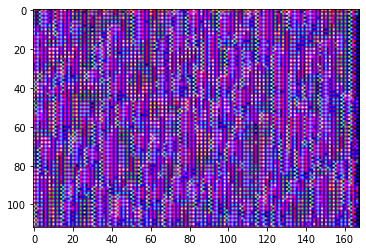

Classifier Accuracy: 83.869%
Epoch  84


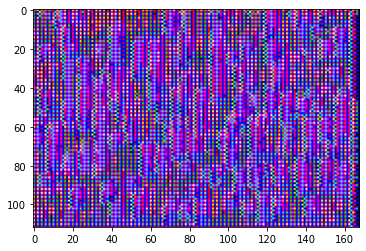

Classifier Accuracy: 88.650%
Epoch  85


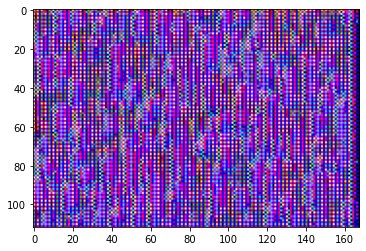

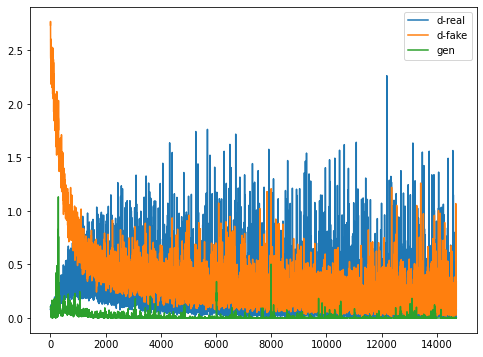

Classifier Accuracy: 88.212%
Epoch  86


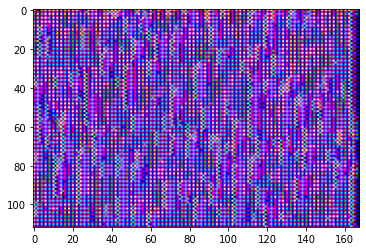

Classifier Accuracy: 87.774%
Epoch  87


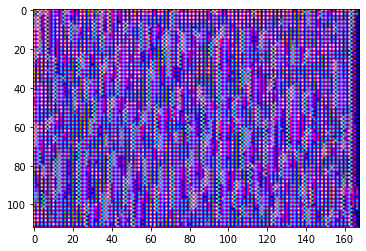

Classifier Accuracy: 70.547%
Epoch  88


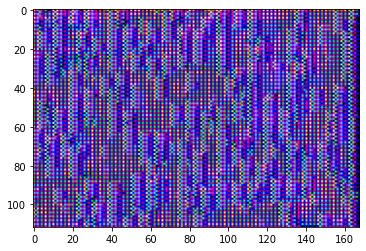

Classifier Accuracy: 84.380%
Epoch  89


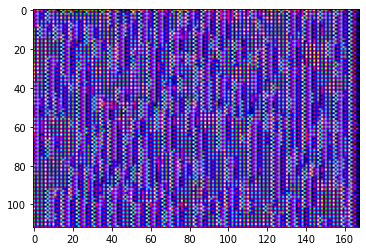

Classifier Accuracy: 87.190%
Epoch  90


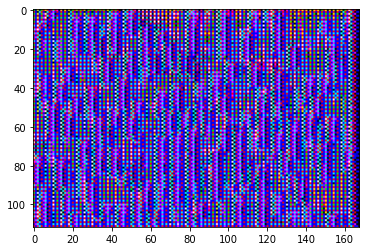

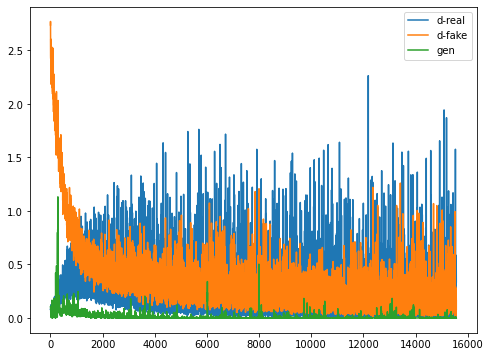

Classifier Accuracy: 90.657%
Epoch  91


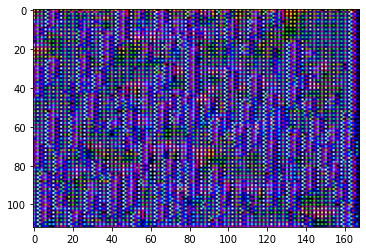

Classifier Accuracy: 91.752%
Epoch  92


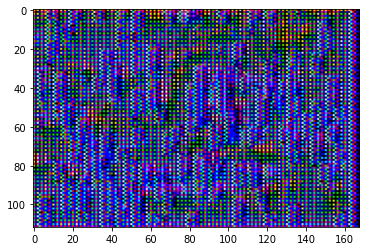

Classifier Accuracy: 94.051%
Epoch  93


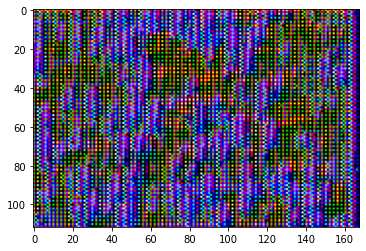

Classifier Accuracy: 95.328%
Epoch  94


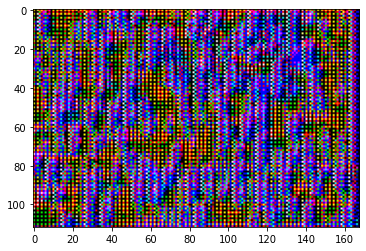

Classifier Accuracy: 90.547%
Epoch  95


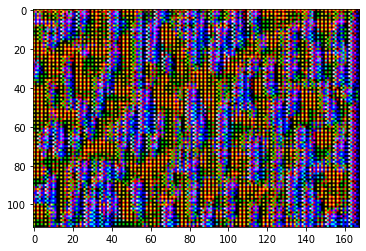

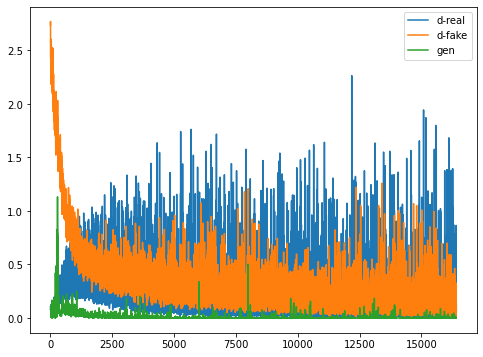

Classifier Accuracy: 91.752%
Epoch  96


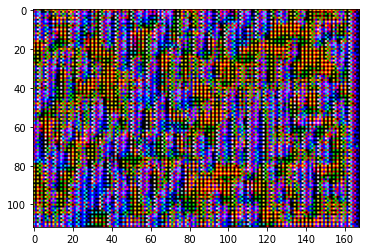

Classifier Accuracy: 90.839%
Epoch  97


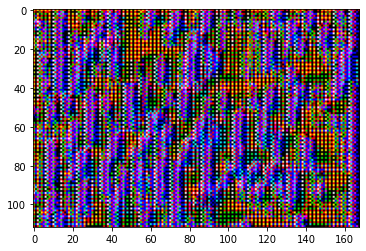

Classifier Accuracy: 90.109%
Epoch  98


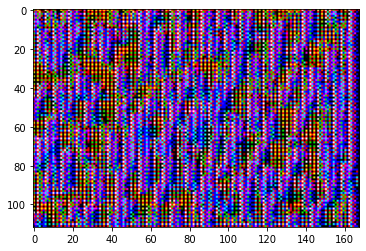

Classifier Accuracy: 90.912%
Epoch  99


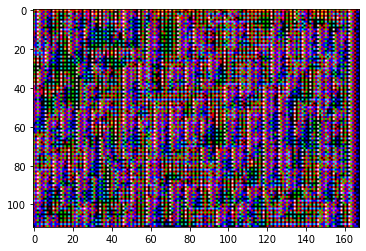

Classifier Accuracy: 90.949%


In [25]:
# size of the latent space
latent_dim = 500
# create the discriminator models
d_model, c_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = [X_train, Y_train]
# train model
d1elist, d2elist, gelist = list(), list(), list()
train(g_model, d_model, c_model, gan_model, dataset,latent_dim,d1elist, d2elist, gelist, n_epochs=100)

In [26]:
loss_table_to_save = pd.DataFrame({'drealloss': d1elist, 'dfakeloss': d2elist, 'genloss': gelist})
loss_table_to_save.to_csv(path_or_buf = 'c_model_v2trial1_lp.csv')

In [39]:
c_model.save('../models/c_model_v2trial1_lp.h5')

## Load and Evaluate

In [40]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, precision_recall_curve
from sklearn.metrics import confusion_matrix
from tensorflow.keras.models import load_model

n_classes=9
n_split =1

In [41]:
model = c_model

In [42]:
# load the best model
# model = load_model('./models/c_model_6840.h5')

In [43]:
all_base_precision = list()
all_base_recall = list()
all_macro_precision = list()
all_macro_recall = list()
all_f1 = list()
all_macro_f1 = list()

all_tpr = list()
all_fpr = list()
all_precision = list()
all_recall = list()
all_cm=list()
all_accuracy = list()

all_df = list()

y_all_labelled=[]
for i in range(len(Y_all)):
        y_all_labelled.append(np.argmax(Y_all[i]))
             


#generate predictions
y_pred = model.predict(X_test)
actual, predicted = generate_actual_predicted(y_pred, X_test, Y_test)

#calc metrics
curr_base_prec, curr_base_rec, curr_f1, _ = precision_recall_fscore_support(actual, predicted)
curr_macro_prec = precision_score(actual, predicted,average='macro')
curr_macro_rec = recall_score(actual, predicted,average='macro')
curr_macro_f1 = f1_score(actual, predicted,average='macro')

actual_labeled = list()
predict_labeled = list()
for x,y in zip(actual,predicted):
    actual_labeled.append(getSpecies(x))
    predict_labeled.append(getSpecies(y))

labels = ['A.tridens','E.bottae','M.emarginatus','P.kuhli','R.muscatellum','R.nasutus', 'R.aegyptius', 'T.perforatus','No_Bat']
curr_cm=confusion_matrix(actual_labeled,predict_labeled,labels=labels)

curr_fpr = [0] * n_classes
curr_tpr = [0] * n_classes
for i in range(n_classes):
    curr_fpr[i], curr_tpr[i], _ = roc_curve(Y_test[:,i], y_pred[:,i])

curr_prec = [0] * n_classes
curr_rec = [0] * n_classes
for i in range(n_classes):
    curr_prec[i], curr_rec[i], _ = precision_recall_curve(Y_test[:,i], y_pred[:,i])


curr_accuracy = accuracy_score(actual, predicted)

#add to lists
all_base_precision.append(curr_base_prec)
all_base_recall.append(curr_base_rec)
all_macro_precision.append(curr_macro_prec)
all_macro_recall.append(curr_macro_rec)

all_f1.append(curr_f1)
all_macro_f1.append(curr_macro_f1)

all_accuracy.append(curr_accuracy)


all_fpr.append(curr_fpr)
all_tpr.append(curr_tpr)
all_precision.append(curr_prec)
all_recall.append(curr_rec)
all_cm.append(curr_cm)


    
    

In [44]:
# for df in all_df:
#     _, axs = plt.subplots(ncols=2)

#     sns.lineplot(data=df['loss'],ax=axs[0], label='Training Loss', legend='brief')
#     sns.lineplot(data=df['val_loss'],ax=axs[0], label='Validation Loss', legend='brief')

#     sns.lineplot(data=df['accuracy'],ax=axs[1], label='Training Accuracy', legend='brief')
#     sns.lineplot(data=df['val_accuracy'],ax=axs[1], label='Validation Accuracy', legend='brief')

In [45]:
print('precision mean by class', np.array(all_base_precision).mean(axis=0))
print('precision sdev by class', np.array(all_base_precision).std(axis=0))

print('macro precision mean', np.array(all_macro_precision).mean())
print('macro precision sdev', np.array(all_macro_precision).std())


print('recall mean', np.array(all_base_recall).mean(axis=0))
print('recall sdev', np.array(all_base_recall).std(axis=0))

print('macro recall mean', np.array(all_macro_recall).mean())
print('macro recall sdev', np.array(all_macro_recall).std())

print('f1 mean', np.array(all_f1).mean(axis=0))
print('f1 sdev', np.array(all_f1).std(axis=0))

print('macro f1 mean', np.array(all_macro_f1).mean())
print('macro f1 sdev', np.array(all_macro_f1).std())

print('accuracy mean', np.array(all_accuracy).mean())
print('accuracy sdev', np.array(all_accuracy).std())



precision mean by class [1.         1.         0.54166667 0.80645161 0.95588235 0.90909091
 0.92857143 0.80645161 1.        ]
precision sdev by class [0. 0. 0. 0. 0. 0. 0. 0. 0.]
macro precision mean 0.8831238425640703
macro precision sdev 0.0
recall mean [0.6        0.72       0.59090909 0.83333333 0.97597598 0.92592593
 0.54166667 0.92592593 0.93902439]
recall sdev [0. 0. 0. 0. 0. 0. 0. 0. 0.]
macro recall mean 0.7836401454423135
macro recall sdev 0.0
f1 mean [0.75       0.8372093  0.56521739 0.81967213 0.96582467 0.91743119
 0.68421053 0.86206897 0.96855346]
f1 sdev [0. 0. 0. 0. 0. 0. 0. 0. 0.]
macro f1 mean 0.8189097371185139
macro f1 sdev 0.0
accuracy mean 0.9096209912536443
accuracy sdev 0.0


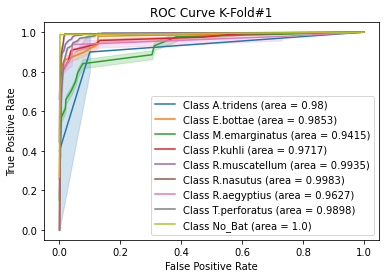

In [46]:
# Plot all K-Fold ROC curves

for i in range(n_split):
    _, axs = plt.subplots(ncols=1)
    axs.set(xlabel='False Positive Rate',ylabel='True Positive Rate', title='ROC Curve K-Fold#'+str(i+1))
    for j in range(n_classes):
        auc_val = auc(all_fpr[i][j], all_tpr[i][j])
        auc_val = np.around(auc_val,4)
        sns.lineplot(x=all_fpr[i][j],y=all_tpr[i][j],ax=axs, label='Class '+ getSpecies(j) +' (area = ' + str(auc_val) + ')', legend='brief')
        

In [47]:
aucs = list()

for i in range(n_classes):
    aucs.append(list())


# Plot all K-Fold ROC curves

for i in range(n_split):
    for j in range(n_classes):
        auc_val = auc(all_fpr[i][j], all_tpr[i][j])
        aucs[j].append(auc_val)
        
for i in range(n_classes):
    print("Sp: ", getSpecies(i))
    print("AUC Mean ", np.array(aucs[i]).mean())
    print("Std ", np.array(aucs[i]).std())

Sp:  A.tridens
AUC Mean  0.9800293685756241
Std  0.0
Sp:  E.bottae
AUC Mean  0.9852950075642964
Std  0.0
Sp:  M.emarginatus
AUC Mean  0.9414704271631982
Std  0.0
Sp:  P.kuhli
AUC Mean  0.9717252396166134
Std  0.0
Sp:  R.muscatellum
AUC Mean  0.9934750614637299
Std  0.0
Sp:  R.nasutus
AUC Mean  0.998271214252227
Std  0.0
Sp:  R.aegyptius
AUC Mean  0.9626762336354483
Std  0.0
Sp:  T.perforatus
AUC Mean  0.9898071625344353
Std  0.0
Sp:  No_Bat
AUC Mean  0.9999596188014861
Std  0.0


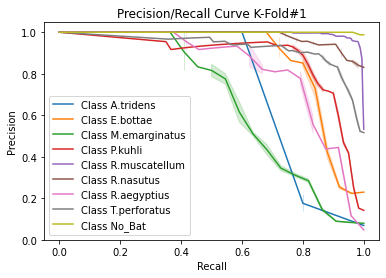

In [48]:
#Plot all K-Fold Precision/Recall curves
for i in range(n_split):
    _, axs = plt.subplots(ncols=1)
    axs.set(xlabel='Recall',ylabel='Precision', title='Precision/Recall Curve K-Fold#'+str(i+1))
    for j in range(n_classes):
        sns.lineplot(x=all_recall[i][j],y=all_precision[i][j],ax=axs, label='Class '+ getSpecies(j), legend='brief')

Confusion Matrix K-Fold #1

[[  3   0   0   0   1   0   0   1   0]
 [  0  18   2   2   1   0   1   1   0]
 [  0   0  13   1   3   0   0   5   0]
 [  0   0   3  50   2   0   0   5   0]
 [  0   0   1   4 325   0   0   3   0]
 [  0   0   0   4   0  50   0   0   0]
 [  0   0   5   1   2   0  13   3   0]
 [  0   0   0   0   6   0   0  75   0]
 [  0   0   0   0   0   5   0   0  77]]




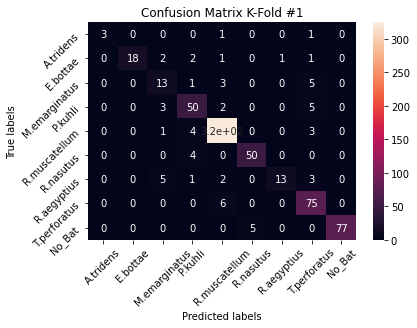

In [49]:
## Plot all K-Fold confusion matrices
import numpy as np
import matplotlib.pylab as pl
import matplotlib.gridspec as gridspec
from matplotlib import pyplot as plt

# Create 1X 5 sub plots
# gs = gridspec.GridSpec(1,n_split)
figs=[]
for i in range(n_split):
    figs.append(plt.figure())
    
for i in range(n_split):
    print('Confusion Matrix K-Fold #'+ str(i+1)+"\n")
    print(all_cm[i])
    print("\n")
    
    ax=figs[i].add_subplot()
    sns.heatmap(all_cm[i], annot=True, ax = ax); #annot=True to annotate cells

    
    # labels, title and ticks
    ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
    ax.set_title('Confusion Matrix K-Fold #'+ str(i+1)); 
    ax.xaxis.set_ticklabels(labels,rotation=45); ax.yaxis.set_ticklabels(labels,rotation=45);

sum of all confuion matrices
 [[  3   0   0   0   1   0   0   1   0]
 [  0  18   2   2   1   0   1   1   0]
 [  0   0  13   1   3   0   0   5   0]
 [  0   0   3  50   2   0   0   5   0]
 [  0   0   1   4 325   0   0   3   0]
 [  0   0   0   4   0  50   0   0   0]
 [  0   0   5   1   2   0  13   3   0]
 [  0   0   0   0   6   0   0  75   0]
 [  0   0   0   0   0   5   0   0  77]]

average of all confuion matrices
 [[  3   0   0   0   1   0   0   1   0]
 [  0  18   2   2   1   0   1   1   0]
 [  0   0  13   1   3   0   0   5   0]
 [  0   0   3  50   2   0   0   5   0]
 [  0   0   1   4 325   0   0   3   0]
 [  0   0   0   4   0  50   0   0   0]
 [  0   0   5   1   2   0  13   3   0]
 [  0   0   0   0   6   0   0  75   0]
 [  0   0   0   0   0   5   0   0  77]]


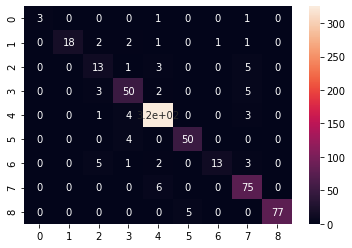

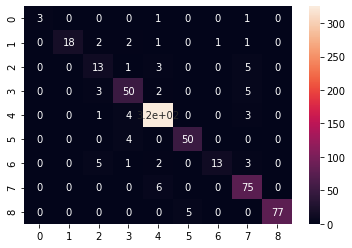

In [50]:
## plot macro cm

sum_all_cm=np.zeros((n_classes,n_classes)).astype('int64')
for i in range(n_split):
    sum_all_cm+=all_cm[i]
    
    
#plot 
figs=[]
for i in range(2):
    figs.append(plt.figure())
       
print("sum of all confuion matrices\n",sum_all_cm)
ax=figs[0].add_subplot()
sns.heatmap(sum_all_cm, annot=True, ax = ax);

avg_all_cm=np.divide(sum_all_cm,n_split).astype('int64')
print("\naverage of all confuion matrices\n",avg_all_cm)
ax=figs[1].add_subplot()
sns.heatmap(avg_all_cm, annot=True, ax = ax);

[[0.6  0.   0.   0.   0.2  0.   0.   0.2  0.  ]
 [0.   0.72 0.08 0.08 0.04 0.   0.04 0.04 0.  ]
 [0.   0.   0.59 0.05 0.14 0.   0.   0.23 0.  ]
 [0.   0.   0.05 0.83 0.03 0.   0.   0.08 0.  ]
 [0.   0.   0.   0.01 0.98 0.   0.   0.01 0.  ]
 [0.   0.   0.   0.07 0.   0.93 0.   0.   0.  ]
 [0.   0.   0.21 0.04 0.08 0.   0.54 0.12 0.  ]
 [0.   0.   0.   0.   0.07 0.   0.   0.93 0.  ]
 [0.   0.   0.   0.   0.   0.06 0.   0.   0.94]]


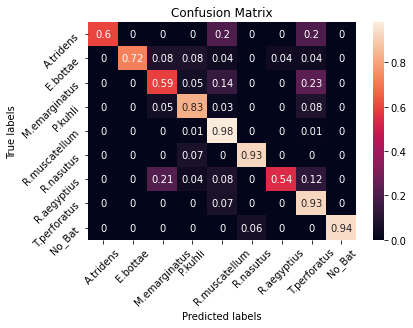

In [51]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


cm= sum_all_cm/ sum_all_cm.astype(np.float).sum(axis=1,keepdims = True)
cm = (np.around(cm,2))
print(cm)


labels = ['A.tridens','E.bottae','M.emarginatus','P.kuhli','R.muscatellum','R.nasutus', 'R.aegyptius', 'T.perforatus','No_Bat']


ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax); #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(labels,rotation=45); ax.yaxis.set_ticklabels(labels,rotation=45);